# Project Name and ID:
## Customer Transaction Prediction (PRCP-1003-CustomerTransactionPrediction)

## Team Id: PTID-CDS-DEC-24-2258

## Project Type: Binary Classification
### Contribution: Anjali Kumbhar and Aarti Salunkhe

## Project Summary
The Customer Transaction Prediction project is about predicting future customer purchases using past data. It looks at customer habits, demographics, and buying patterns to create models that forecast the chances of a customer buying something. This helps businesses improve marketing, target the right customers, and predict sales better. The project uses simple tools like logistic regression, decision trees, and Random Forest Classifier,Mlp and Knearest Neighbour Classifier to make accurate predictions and useful suggestions.

## Problem Statement
The goal of this project is to create a predictive model that helps the bank identify which customers are likely to make transactions in the future. By analyzing past transaction data, customer demographics, and behavior patterns, the model will predict the likelihood of future activity. This will help the bank target customers with personalized offers, optimize marketing efforts, and improve customer engagement. The model will enable better decision-making and enhance customer retention.

### IMPORTING ALL THE REQUIRED LIBRARIES

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score,f1_score
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
import pickle
import math
from collections import Counter
from imblearn.over_sampling import SMOTE

### LOADING DATASET

In [2]:
df=pd.read_csv('train(1).csv')

In [3]:
df

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,train_199995,0,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,train_199996,0,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,train_199997,0,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,train_199998,0,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001


###  BASIC CHECKS

#### CHECKING FIRST FIVE ROWS

In [4]:
df.head()

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,...,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,...,7.6421,7.7214,2.5837,10.9516,15.4305,2.0339,8.1267,8.7889,18.3560,1.9518
2,train_2,0,8.6093,-2.7457,12.0805,7.8928,10.5825,-9.0837,6.9427,14.6155,...,2.9057,9.7905,1.6704,1.6858,21.6042,3.1417,-6.5213,8.2675,14.7222,0.3965
3,train_3,0,11.0604,-2.1518,8.9522,7.1957,12.5846,-1.8361,5.8428,14.9250,...,4.4666,4.7433,0.7178,1.4214,23.0347,-1.2706,-2.9275,10.2922,17.9697,-8.9996
4,train_4,0,9.8369,-1.4834,12.8746,6.6375,12.2772,2.4486,5.9405,19.2514,...,-1.4905,9.5214,-0.1508,9.1942,13.2876,-1.5121,3.9267,9.5031,17.9974,-8.8104


#### CHECKING LAST FIVE ROWS

In [5]:
df.tail()

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,...,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
199995,train_199995,0,11.4880,-0.4956,8.2622,3.5142,10.3404,11.6081,5.6709,15.1516,...,6.1415,13.2305,3.9901,0.9388,18.0249,-1.7939,2.1661,8.5326,16.6660,-17.8661
199996,train_199996,0,4.9149,-2.4484,16.7052,6.6345,8.3096,-10.5628,5.8802,21.5940,...,4.9611,4.6549,0.6998,1.8341,22.2717,1.7337,-2.1651,6.7419,15.9054,0.3388
199997,train_199997,0,11.2232,-5.0518,10.5127,5.6456,9.3410,-5.4086,4.5555,21.5571,...,4.0651,5.4414,3.1032,4.8793,23.5311,-1.5736,1.2832,8.7155,13.8329,4.1995
199998,train_199998,0,9.7148,-8.6098,13.6104,5.7930,12.5173,0.5339,6.0479,17.0152,...,2.6840,8.6587,2.7337,11.1178,20.4158,-0.0786,6.7980,10.0342,15.5289,-13.9001
199999,train_199999,0,10.8762,-5.7105,12.1183,8.0328,11.5577,0.3488,5.2839,15.2058,...,8.9842,1.6893,0.1276,0.3766,15.2101,-2.4907,-2.2342,8.1857,12.1284,0.1385


#### CHECKING ALL THE COLUMNS

In [4]:
pd.set_option('display.max_columns',None)
df

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,8.9255,-6.7863,11.9081,5.0930,11.4607,-9.2834,5.1187,18.6266,-4.9200,5.7470,2.9252,3.1821,14.0137,0.5745,8.7989,14.5691,5.7487,-7.2393,4.2840,30.7133,10.5350,16.2191,2.5791,2.4716,14.3831,13.4325,-5.1488,-0.4073,4.9306,5.9965,-0.3085,12.9041,-3.8766,16.8911,11.1920,10.5785,0.6764,7.8871,4.6667,3.8743,-5.2387,7.3746,11.5767,12.0446,11.6418,-7.0170,5.9226,-14.2136,16.0283,5.3253,12.9194,29.0460,-0.6940,5.1736,-0.7474,14.8322,11.2668,5.3822,2.0183,10.1166,16.1828,4.9590,2.0771,-0.2154,8.6748,9.5319,5.8056,22.4321,5.0109,-4.7010,21.6374,0.5663,5.1999,8.8600,43.1127,18.3816,-2.3440,23.4104,6.5199,12.1983,13.6468,13.8372,1.3675,2.9423,-4.5213,21.4669,9.3225,16.4597,7.9984,-1.7069,-21.4494,6.7806,11.0924,9.9913,14.8421,0.1812,8.9642,16.2572,2.1743,-3.4132,9.4763,13.3102,26.5376,1.4403,14.7100,6.0454,9.5426,17.1554,14.1104,24.3627,2.0323,6.7602,3.9141,-0.4851,2.5240,1.5093,2.5516,15.5752,-13.4221,7.2739,16.0094,9.7268,0.8897,0.7754,4.2218,12.0039,13.8571,-0.7338,-1.9245,15.4462,12.8287,0.3587,9.6508,6.5674,5.1726,3.1345,29.4547,31.4045,2.8279,15.6599,8.3307,-5.6011,19.0614,11.2663,8.6989,8.3694,11.5659,-16.4727,4.0288,17.9244,18.5177,10.7800,9.0056,16.6964,10.4838,1.6573,12.1749,-13.1324,17.6054,11.5423,15.4576,5.3133,3.6159,5.0384,6.6760,12.6644,2.7004,-0.6975,9.5981,5.4879,-4.7645,-8.4254,20.8773,3.1531,18.5618,7.7423,-10.1245,13.7241,-3.5189,1.7202,-8.4051,9.0164,3.0657,14.3691,25.8398,5.8764,11.8411,-19.7159,17.5743,0.5857,4.4354,3.9642,3.1364,1.6910,18.5227,-2.3978,7.8784,8.5635,12.7803,-1.0914
1,train_1,0,11.5006,-4.1473,13.8588,5.3890,12.3622,7.0433,5.6208,16.5338,3.1468,8.0851,-0.4032,8.0585,14.0239,8.4135,5.4345,13.7003,13.8275,-15.5849,7.8000,28.5708,3.4287,2.7407,8.5524,3.3716,6.9779,13.8910,-11.7684,-2.5586,5.0464,0.5481,-9.2987,7.8755,1.2859,19.3710,11.3702,0.7399,2.7995,5.8434,10.8160,3.6783,-11.1147,1.8730,9.8775,11.7842,1.2444,-47.3797,7.3718,0.1948,34.4014,25.7037,11.8343,13.2256,-4.1083,6.6885,-8.0946,18.5995,19.3219,7.0118,1.9210,8.8682,8.0109,-7.2417,1.7944,-1.3147,8.1042,1.5365,5.4007,7.9344,5.0220,2.2302,40.5632,0.5134,3.1701,20.1068,7.7841,7.0529,3.2709,23.4822,5.5075,13.7814,2.5462,18.1782,0.3683,-4.8210,-5.4850,13.7867,-13.5901,11.0993,7.9022,12.2301,0.4768,6.8852,8.0905,10.9631,11.7569,-1.2722,24.7876,26.6881,1.8944,0.6939,-13.6950,8.4068,35.4734,1.7093,15.1866,2.6227,7.3412,32.0888,13.9550,13.0858,6.6203,7.1051,5.3523,8.5426,3.6159,4.1569,3.0454,7.8522,-11.5100,7.5109,31.5899,9.5018,8.2736,10.1633,0.1225,12.5942,14.5697

#### DOMAIN ANALYSIS

- The aim of this project is to predict which customers are likely to make a specific transaction in the future, regardless of how much money they will spend.
- By analyzing past transaction data and customer behaviors (like frequency of purchases, types of products, and engagement), the goal is to identify patterns that can forecast which customers are most likely to buy again.
- This prediction can help businesses focus on the right customers for targeted marketing and improve their sales strategies, without needing to predict the exact amount of money involved.
- The dataset includes 200,000 entries with 202 columns in total: 200 columns represent various features (labeled from var_1 to var_200), one column holds the customer ID, and one column indicates whether the customer will make a transaction or not (the target outcome).
#### TARGET COLUMN == TARGET [0, 1]
###### 0 Represent -- CUSTOMER DID NOT DO A TRANSACTION
###### 1 Represent -- CUSTOMER DID DO THE TRANSACTION

#### CHECKING SIZE AND SHAPE

In [7]:
print(f" Shape of Data {df.shape}")
print(f" Size of Data {df.size}")

 Shape of Data (200000, 202)
 Size of Data 40400000


#### CHECKING INFO 

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Columns: 202 entries, ID_code to var_199
dtypes: float64(200), int64(1), object(1)
memory usage: 308.2+ MB


## Insights
- In this data all types of datatype is available
- [float,int,object]

### CHECKING ALL THE COLUMNS NAME

In [9]:
df.columns

Index(['ID_code', 'target', 'var_0', 'var_1', 'var_2', 'var_3', 'var_4',
       'var_5', 'var_6', 'var_7',
       ...
       'var_190', 'var_191', 'var_192', 'var_193', 'var_194', 'var_195',
       'var_196', 'var_197', 'var_198', 'var_199'],
      dtype='object', length=202)

## Insights
- Total 202 column with target and one unique column

In [10]:
df.index

RangeIndex(start=0, stop=200000, step=1)

## Insights
- The dataset contain 200000 Observation with 1 step

In [11]:
df.dtypes.value_counts()

float64    200
object       1
int64        1
Name: count, dtype: int64

## Insights
* There is almost columns are in float but 1 object column is present which is column id we will drop that

#### CHEKING FOR MISSING VALUES

In [12]:
null_count = sum(df.isnull().any())

print("There are {} NULL values in the dataframe".format(null_count))

There are 0 NULL values in the dataframe


## Insights:
* Seems there aren't NULL values so that's good, no need to deal with it


#### CHECKING FOR STATISTICAL INFORMATION

In [13]:
df.describe()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
count,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,200000.000000,2000

## Insights
- No constant Column is present in data

#### STATISTICAL INFO FOR OBJECT COLUMNS

In [14]:
df.describe(include='O')

,ID_code
count,200000
unique,200000
top,train_0
freq,1


## Insights:
* As we see this is Unique column so we will drop this column

#### CALCULATE AND PRINT THE DISTRIBUTION OF THE TARGET VARIABLE

In [15]:
obs_0, obs_1 = df["target"].value_counts()
total = df.shape[0]

print(f"There are {obs_0:,} observations with target value 0, and {obs_1:,} with target value 1")
print(f"Target 0 represents {obs_0/total*100:.2f}%, while target 1 represents {obs_1/total*100:.2f}%")


There are 179,902 observations with target value 0, and 20,098 with target value 1
Target 0 represents 89.95%, while target 1 represents 10.05%


## Insights:
* Clearly an imbalanced dataset, an over/under-sampling strategy will be needed.

### CHECKING UNIQUE VALUE IN EACH COLUMN

In [16]:
df.nunique()

ID_code    200000
target          2
var_0       94672
var_1      108932
var_2       86555
            ...  
var_195     57870
var_196    125560
var_197     40537
var_198     94153
var_199    149430
Length: 202, dtype: int64

In [17]:
df.duplicated().sum()

0

### EXPLORATORY DATA ANALYSIS

##### TARGET COLUMN

In [18]:
df.target.value_counts()

target
0    179902
1     20098
Name: count, dtype: int64

## IMPORTANT NOTE:
* IN THIS DATA WE NOT DO ANY DOMAIN ANALYSIS BECAUSE OF WE DONT HAVE ANY FEATURE NAME BECAUSE THE DATA IS CONTAIN PRIVATE INFORMATION OF CUSTOMER DETAILS OF BANK

#### SOME RANDOM BOXPLOT AGAINS TARGET 

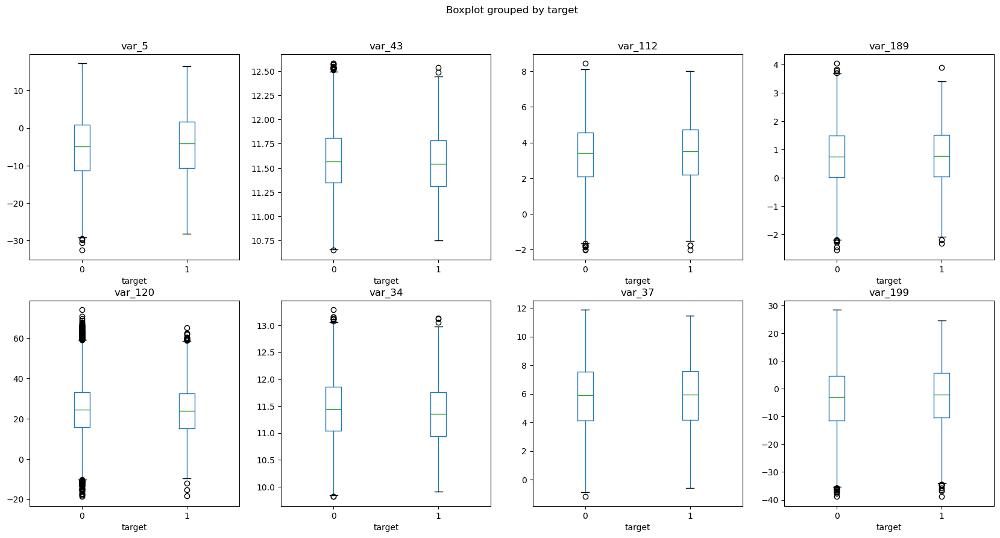

In [19]:
fig, ax = plt.subplots(2,4,figsize=(20,10), sharey=False);
df.boxplot(["var_5", "var_43", "var_112", "var_189", "var_120", "var_34", "var_37", "var_199"], by="target", grid=False, ax=ax);

#### CHECKING DISTRIBUTION OF FIRST 100 FEATURE 

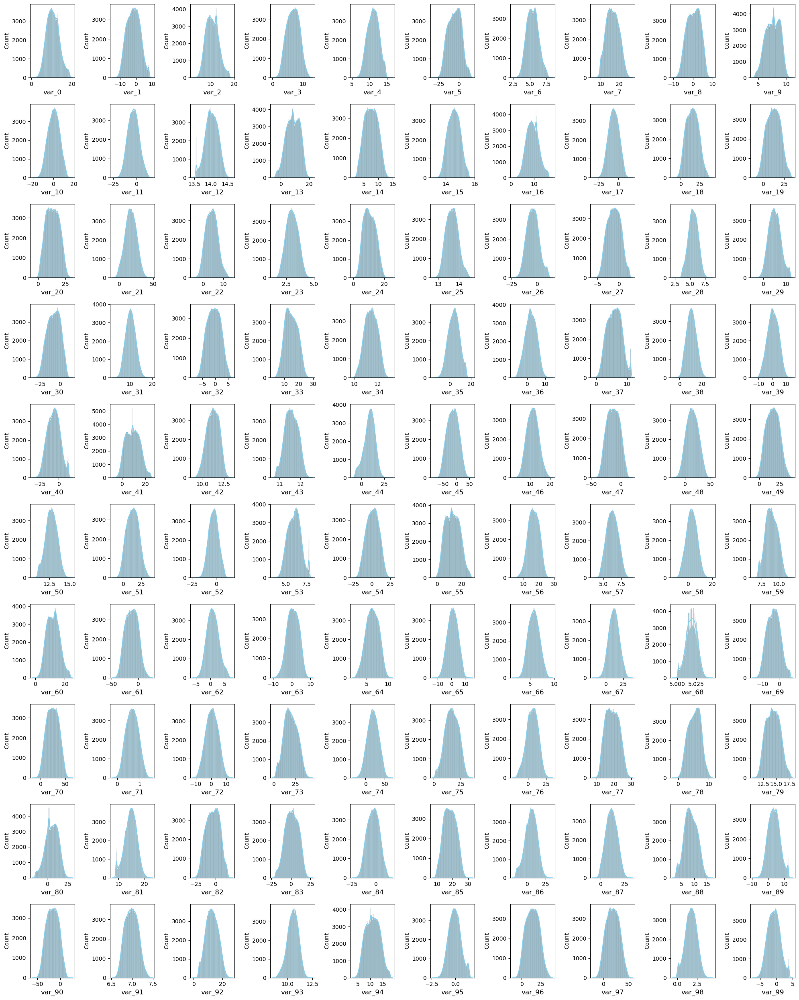

In [20]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select the feature columns
dist = df.iloc[:, 2:102]

# Define canvas size and plotting setup
plt.figure(figsize=(20, 25), facecolor='white')

# Plot histograms with KDE
for i, column in enumerate(dist.columns, 1):
    if i <= 100:
        plt.subplot(10, 10, i)
        sns.histplot(dist[column], kde=True, color='skyblue')
        plt.xlabel(column, fontsize=12)

plt.tight_layout()
plt.show()


#### CHECKING DISTRIBUTION OF REMAINING FEATURE 

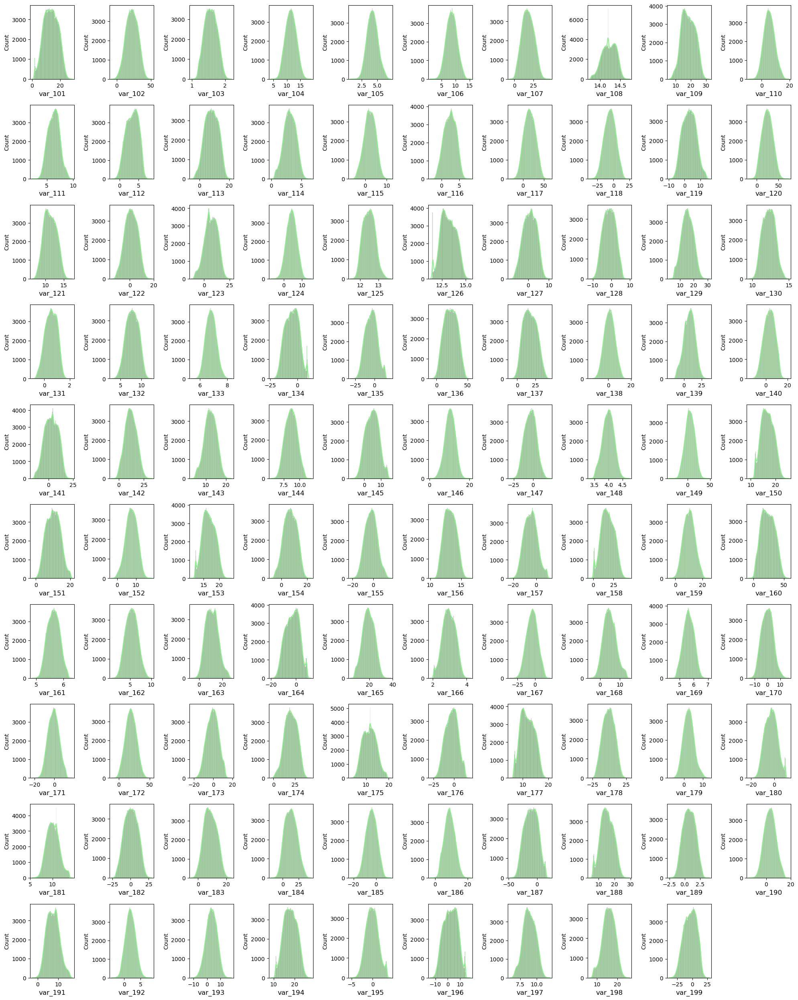

In [21]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select feature columns starting from column 103
dist1 = df.iloc[:, 103:]

# Define canvas size and plotting setup
plt.figure(figsize=(20, 25), facecolor='white')

# Plot histograms with KDE
for i, column in enumerate(dist1.columns, 1):
    if i <= 100:
        plt.subplot(10, 10, i)
        sns.histplot(dist1[column], kde=True, color='lightgreen')
        plt.xlabel(column, fontsize=12)

plt.tight_layout()
plt.show()


## Insights
##### OBSERVATION:
* From above both plots we are clearly see that most of the feature is follow a normal distribution and some feature are very close to the noramal distribution so we not need to use feature transformation technique.

### STATISTICAL ANALYSIS

#### DISTRIBUTION OF MEAN AND STANDARD DEVIATION OF THE DATA

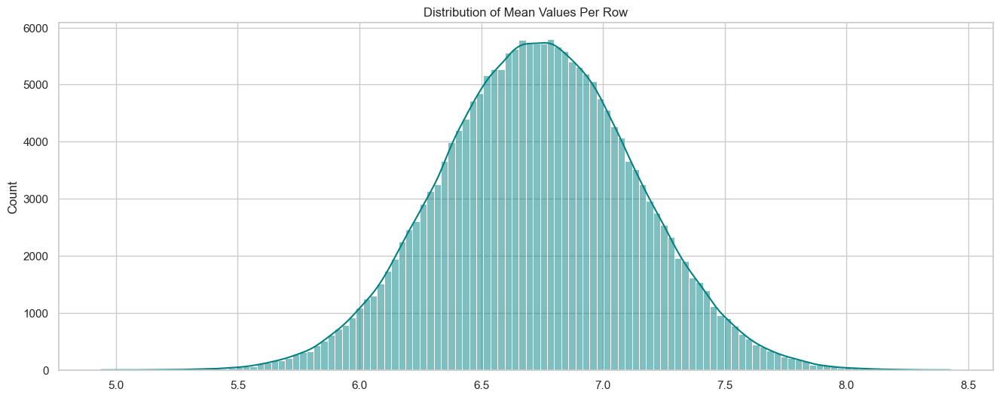

In [22]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style='whitegrid')
plt.figure(figsize=(16, 6))
sns.histplot(df.iloc[:, 1:202].mean(axis=1), color='teal', kde=True, bins=120)
plt.title('Distribution of Mean Values Per Row')
plt.show()



## Insights:
* From the above graph looks like guassian distribution with mean value 6.73
* From above graph we can say that around 80% feature mean lies between 6.5 to 7.0

#### DISTRIBUTION OF STANDARD DEVIATION OF DATA

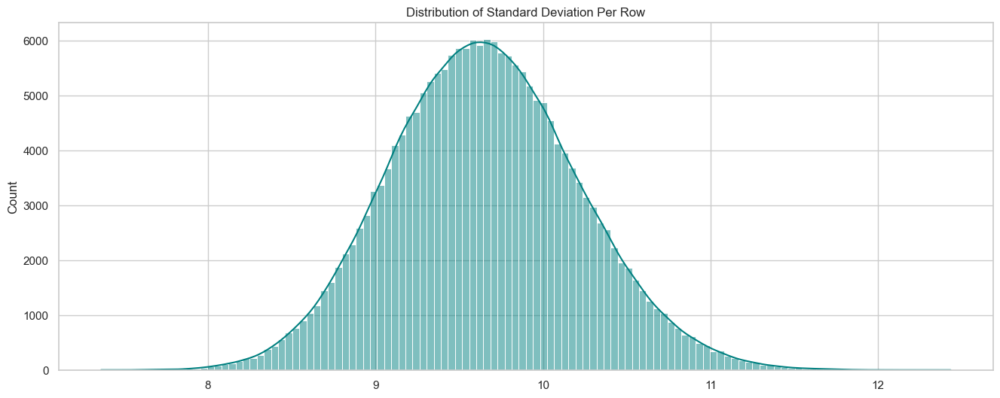

In [23]:
import matplotlib.pyplot as plt
import seaborn as sns

sns.set(style='whitegrid')
plt.figure(figsize=(16, 6))
sns.histplot(df.iloc[:, 1:202].std(axis=1), color='teal', kde=True, bins=120)
plt.title('Distribution of Standard Deviation Per Row')
plt.show()


## Insights
##### OBSERVATION:
* This graph also look like guassian distribution around 60% of feature standard deviation around the range of 9 to 10

### 1.DATA PREPROCESSING / FEATURE ENIGNEERING


### 1.CHECK MISSING VALUE

In [24]:
df.isna().sum()

ID_code    0
target     0
var_0      0
var_1      0
var_2      0
          ..
var_195    0
var_196    0
var_197    0
var_198    0
var_199    0
Length: 202, dtype: int64

In [25]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

missing_count = df.isna().sum()
missing_percentage = (df.isna().sum() / len(df)) * 100

missing_data = pd.DataFrame({'Missing Count': missing_count, 'Missing Percentage': missing_percentage})

missing_data = missing_data.sort_values('Missing Count', ascending=False)
pd.set_option('display.max_rows',None)
print(missing_data)


         Missing Count  Missing Percentage
ID_code              0                 0.0
var_136              0                 0.0
var_126              0                 0.0
var_127              0                 0.0
var_128              0                 0.0
var_129              0                 0.0
var_130              0                 0.0
var_131              0                 0.0
var_132              0                 0.0
var_133              0                 0.0
var_134              0                 0.0
var_135              0                 0.0
var_137              0                 0.0
var_149              0                 0.0
var_138              0                 0.0
var_139              0                 0.0
var_140              0                 0.0
var_141              0                 0.0
var_142              0                 0.0
var_143              0                 0.0
var_144              0                 0.0
var_145              0                 0.0
var_146    

## Insights
In This Dataset No missing Values

### 2.OUTLIER HANDLING

* From the above EDA we seen the feature are very close to the normal distribution as well as distance between point is very less so we are not impute the outlier we are use scaling to robust the outlier

### 3.FEATURE SCALING

* Here we are use robust scaling because the data set contain the outlier but feature is follow a normal distribution
* robust scaler is similar to normalization but it insted uses the interquatile range, so that is robust to outlier

In [5]:
from sklearn.preprocessing import RobustScaler

# Define the list of columns to scale
cols_to_scale = [f'var_{i}' for i in range(200)]  # or specify the columns directly if needed

# Create the scaler object
scaler = RobustScaler()

# Apply the scaler to the selected columns
df[cols_to_scale] = scaler.fit_transform(df[cols_to_scale])


In [6]:
df.head()

,ID_code,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,train_0,0,-0.371543,-0.849081,0.350032,-0.564165,0.148216,-0.367026,-0.215656,0.420577,-1.011036,-0.957762,0.305583,0.773493,-0.043671,-1.114937,0.366513,-0.008174,-0.966624,-0.162739,-0.922003,1.501988,-0.287712,-0.087983,-0.412584,-0.697739,0.682295,-0.564694,-0.115641,0.311940,-0.548520,0.288457,0.576435,0.841940,-0.851126,0.348616,-0.299471,0.903673,-0.340591,0.581356,-0.981379,0.548539,0.115367,-0.193612,0.319345,1.040799,0.283599,0.173463,-1.324016,-0.105497,0.088093,-0.953893,0.180010,1.287471,0.258004,-0.771426,-0.161079,0.250831,-1.036505,-0.760518,-0.191132,0.969281,0.663865,0.953312,0.457902,-0.194641,1.045515,1.563864,0.014637,1.021941,-0.811881,-0.235622,-0.152782,-0.260393,0.797759,-0.940584,1.177347,0.171753,-0.770042,0.737181,0.354058,-1.091074,0.705281,-0.322230,0.354930,0.149136,-0.217689,0.526629,0.308423,0.631770,-0.169341,-1.068672,-0.245199,-0.889417,-0.256259,-0.788603,0.905459,0.326678,-0.415107,-0.116685,0.408769,-1.002733,1.191061,-0.009283,0.334864,-0.454611,1.145443,1.539743,0.354209,-0.037369,-0.441993,0.901512,-0.635917,0.267546,0.203524,-1.270972,-0.393360,-0.198976,0.038224,-0.019047,-0.655480,0.678865,-0.479367,-0.576777,-0.040617,-0.724279,-0.020919,-1.020520,0.573672,-0.345920,-0.166804,0.003252,0.448584,-0.285488,0.842093,-0.453821,1.045512,0.653827,0.403910,1.027436,0.252403,0.700201,0.661924,-0.828965,0.881523,-0.262672,0.034931,0.598285,0.337620,-1.233241,0.117986,0.866341,0.477374,0.108810,0.313432,0.015391,0.469908,0.456423,-0.694127,-1.039317,-0.002129,0.226414,-0.496664,-0.995956,-0.852672,-0.757186,1.106464,-0.907538,-0.478894,0.302331,1.120384,-0.275810,-0.750177,-0.992302,0.092748,0.431413,-0.155465,-0.900226,-0.683989,0.481938,-0.202353,-0.210354,-0.745271,-0.529248,0.172926,0.860504,0.965631,1.451151,0.656221,-0.535886,0.399552,-0.106880,0.190533,-0.776912,0.599643,-0.303378,0.118478,-1.112383,0.643194,-0.242223,-0.744683,0.107705
1,train_1,0,0.226713,-0.416363,0.864155,-0.467749,0.527324,0.979489,0.190804,0.014925,0.523831,0.231733,-0.111621,1.356555,-0.005922,-0.026486,-0.597899,-1.428478,1.275230,-1.026186,-0.624927,1.325749,-1.055828,-1.256152,1.040491,0.471547,-0.579970,0.561012,-0.919817,-0.613938,-0.443401,-1.213627,-0.153128,-0.825920,0.449260,0.722049,-0.080039,-0.431143,0.134638,-0.016755,0.042161,0.514962,-0.376309,-0.789331,-1.308709,0.475694,-1.053919,-1.092571,-0.967908,0.772529,1.189818,0.759215,-0.943863,-0.018056,-0.229100,0.596677,-0.746539,0.673046,0.514992,0.647343,-0.207278,-0.026

* data Scaled successfully

## FEATURE SELECTION
### 1.DROP UNIQUE AND CONSTANT FEATURE

* Here we are going to drop id_code

In [7]:
df.drop('ID_code',axis=1,inplace=True)

In [8]:
df.head()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
0,0,-0.371543,-0.849081,0.350032,-0.564165,0.148216,-0.367026,-0.215656,0.420577,-1.011036,-0.957762,0.305583,0.773493,-0.043671,-1.114937,0.366513,-0.008174,-0.966624,-0.162739,-0.922003,1.501988,-0.287712,-0.087983,-0.412584,-0.697739,0.682295,-0.564694,-0.115641,0.311940,-0.548520,0.288457,0.576435,0.841940,-0.851126,0.348616,-0.299471,0.903673,-0.340591,0.581356,-0.981379,0.548539,0.115367,-0.193612,0.319345,1.040799,0.283599,0.173463,-1.324016,-0.105497,0.088093,-0.953893,0.180010,1.287471,0.258004,-0.771426,-0.161079,0.250831,-1.036505,-0.760518,-0.191132,0.969281,0.663865,0.953312,0.457902,-0.194641,1.045515,1.563864,0.014637,1.021941,-0.811881,-0.235622,-0.152782,-0.260393,0.797759,-0.940584,1.177347,0.171753,-0.770042,0.737181,0.354058,-1.091074,0.705281,-0.322230,0.354930,0.149136,-0.217689,0.526629,0.308423,0.631770,-0.169341,-1.068672,-0.245199,-0.889417,-0.256259,-0.788603,0.905459,0.326678,-0.415107,-0.116685,0.408769,-1.002733,1.191061,-0.009283,0.334864,-0.454611,1.145443,1.539743,0.354209,-0.037369,-0.441993,0.901512,-0.635917,0.267546,0.203524,-1.270972,-0.393360,-0.198976,0.038224,-0.019047,-0.655480,0.678865,-0.479367,-0.576777,-0.040617,-0.724279,-0.020919,-1.020520,0.573672,-0.345920,-0.166804,0.003252,0.448584,-0.285488,0.842093,-0.453821,1.045512,0.653827,0.403910,1.027436,0.252403,0.700201,0.661924,-0.828965,0.881523,-0.262672,0.034931,0.598285,0.337620,-1.233241,0.117986,0.866341,0.477374,0.108810,0.313432,0.015391,0.469908,0.456423,-0.694127,-1.039317,-0.002129,0.226414,-0.496664,-0.995956,-0.852672,-0.757186,1.106464,-0.907538,-0.478894,0.302331,1.120384,-0.275810,-0.750177,-0.992302,0.092748,0.431413,-0.155465,-0.900226,-0.683989,0.481938,-0.202353,-0.210354,-0.745271,-0.529248,0.172926,0.860504,0.965631,1.451151,0.656221,-0.535886,0.399552,-0.106880,0.190533,-0.776912,0.599643,-0.303378,0.118478,-1.112383,0.643194,-0.242223,-0.744683,0.107705
1,0,0.226713,-0.416363,0.864155,-0.467749,0.527324,0.979489,0.190804,0.014925,0.523831,0.231733,-0.111621,1.356555,-0.005922,-0.026486,-0.597899,-1.428478,1.275230,-1.026186,-0.624927,1.325749,-1.055828,-1.256152,1.040491,0.471547,-0.579970,0.561012,-0.919817,-0.613938,-0.443401,-1.213627,-0.153128,-0.825920,0.449260,0.722049,-0.080039,-0.431143,0.134638,-0.016755,0.042161,0.514962,-0.376309,-0.789331,-1.308709,0.475694,-1.053919,-1.092571,-0.967908,0.772529,1.189818,0.759215,-0.943863,-0.018056,-0.229100,0.596677,-0.746539,0.673046,0.514992,0.647343,-0.207278,-0.026154,-0.653387,0.263081,0

### 2.CHECKING CORRELATION

In [30]:
df.corr()

,target,var_0,var_1,var_2,var_3,var_4,var_5,var_6,var_7,var_8,var_9,var_10,var_11,var_12,var_13,var_14,var_15,var_16,var_17,var_18,var_19,var_20,var_21,var_22,var_23,var_24,var_25,var_26,var_27,var_28,var_29,var_30,var_31,var_32,var_33,var_34,var_35,var_36,var_37,var_38,var_39,var_40,var_41,var_42,var_43,var_44,var_45,var_46,var_47,var_48,var_49,var_50,var_51,var_52,var_53,var_54,var_55,var_56,var_57,var_58,var_59,var_60,var_61,var_62,var_63,var_64,var_65,var_66,var_67,var_68,var_69,var_70,var_71,var_72,var_73,var_74,var_75,var_76,var_77,var_78,var_79,var_80,var_81,var_82,var_83,var_84,var_85,var_86,var_87,var_88,var_89,var_90,var_91,var_92,var_93,var_94,var_95,var_96,var_97,var_98,var_99,var_100,var_101,var_102,var_103,var_104,var_105,var_106,var_107,var_108,var_109,var_110,var_111,var_112,var_113,var_114,var_115,var_116,var_117,var_118,var_119,var_120,var_121,var_122,var_123,var_124,var_125,var_126,var_127,var_128,var_129,var_130,var_131,var_132,var_133,var_134,var_135,var_136,var_137,var_138,var_139,var_140,var_141,var_142,var_143,var_144,var_145,var_146,var_147,var_148,var_149,var_150,var_151,var_152,var_153,var_154,var_155,var_156,var_157,var_158,var_159,var_160,var_161,var_162,var_163,var_164,var_165,var_166,var_167,var_168,var_169,var_170,var_171,var_172,var_173,var_174,var_175,var_176,var_177,var_178,var_179,var_180,var_181,var_182,var_183,var_184,var_185,var_186,var_187,var_188,var_189,var_190,var_191,var_192,var_193,var_194,var_195,var_196,var_197,var_198,var_199
target,1.000000,0.052390,0.050343,0.055870,0.011055,0.010915,0.030979,6.673085e-02,-0.003025,0.019584,-0.042805,-0.002213,0.022993,-6.948928e-02,-0.055156,-0.006332,0.017283,0.008117,0.000864,0.043479,0.011291,-0.018329,-0.058483,0.060558,-0.025473,0.028477,0.013328,0.062422,-5.818916e-04,-0.023942,0.004682,0.000638,-0.025619,0.030513,-0.044334,-0.052692,0.036567,-0.038397,0.007685,0.000970,-0.004090,0.049530,-0.001298,-0.008365,-0.028557,-4.903939e-02,-0.020065,0.005690,0.008983,0.032334,0.030612,-0.013900,0.025992,0.027754,0.063399,-0.015796,0.017176,-0.035000,-0.015468,-0.024277,-0.010448,0.006265,0.007407,0.013888,-0.014670,-0.013805,0.011214,0.023114,0.044673,-0.011957,0.008283,0.026748,0.033607,-0.013005,-0.006460,0.019926,-3.808113e-02,-0.061917,-0.017459,0.048245,0.007591,-0.057609,-0.080917,0.022574,-0.020528,0.012363,-0.024513,-0.039126,-0.035860,-0.020677,0.039369,0.029395,0.040127,-0.046295,-0.035070,0.046296,0.038531,0.003037,0.015224,-0.004074,0.058367,2.215327e-03,-0.009138,-0.018329,-0.001395,-0.026605,0.025604,0.032947,-0.039997,-0.044791,-4.992600e-02,0.064275,0.026686,0.023694,-0.013681,-0.026266,-0.050174,-2.344771e-02,0.002591,0.040358,0.030975,-0.010895,-0.039788,-0.042461,-0.040291,0.004218,0.028223,1.392930e-03,-0.039125,0.026909,-0.005880,0.029917,-0.032380,-0.024510,0.054548,0.017213,0.027944,-0.003554,0.027190,0.018328,-0.074080,0.015301,-0.029701,-1.890064e-02,-0.011202,2.120786e-02,0.030917,-0.063644,0.040280,-0.055011,-0.047319,-2.582110e-02,0.027524,-0.010773,-0.007103,-0.046106,0.037240,-0.020997,0.032642,-0.003817,0.015278,-0.005135,0.004168,0.032647,0.031811,0.040997,-0.055734,-0.057773,0.030797,0.014115,-0.048382,0.047973,0.014873,-0.037976,4.202224e-02,-0.061669,0.021692,0.007469,-3.686307e-02,-0.019681,0.050002,0.031190,1.371375e-02,-0.007198,-0.005467,0.048315,0.000053,-0.030421,0.014873,-0.034015,0.009212,0.055973,4.711368e-02,-0.042858,-0.017709,-0.022838,0.028285,0.023608,-0.035303,-0.053000,0.025434
var_0,0.052390,1.000000,-0.000544,0.006573,0.003801,0.001326,0.003046,6.982549e-03,0.002429,0.004962,-0.002613,0.000355,0.003468,-1.995731e-03,-0.002717,-0.004584,-0.000043,0.001112,-0.001664,0.004292,0.001505,-0.000932,0.000781,0.002322,-0.000987,0.003658,0.001158,0.006117,9.846974e-04,0.001081,-0.000426,0.003187,-0.002097,0.000274,-0.003343,-0.003933,0.001469,-0.002556,-0.000253,-0.000470,-0.001409,0.006798,0.001152,-0.000440,0.002685,-3.003208e-03,-0.001539,0.000129,0.004062,0.003767,0.000524,-0.004678,0.001217,0.00303

## HeatMap

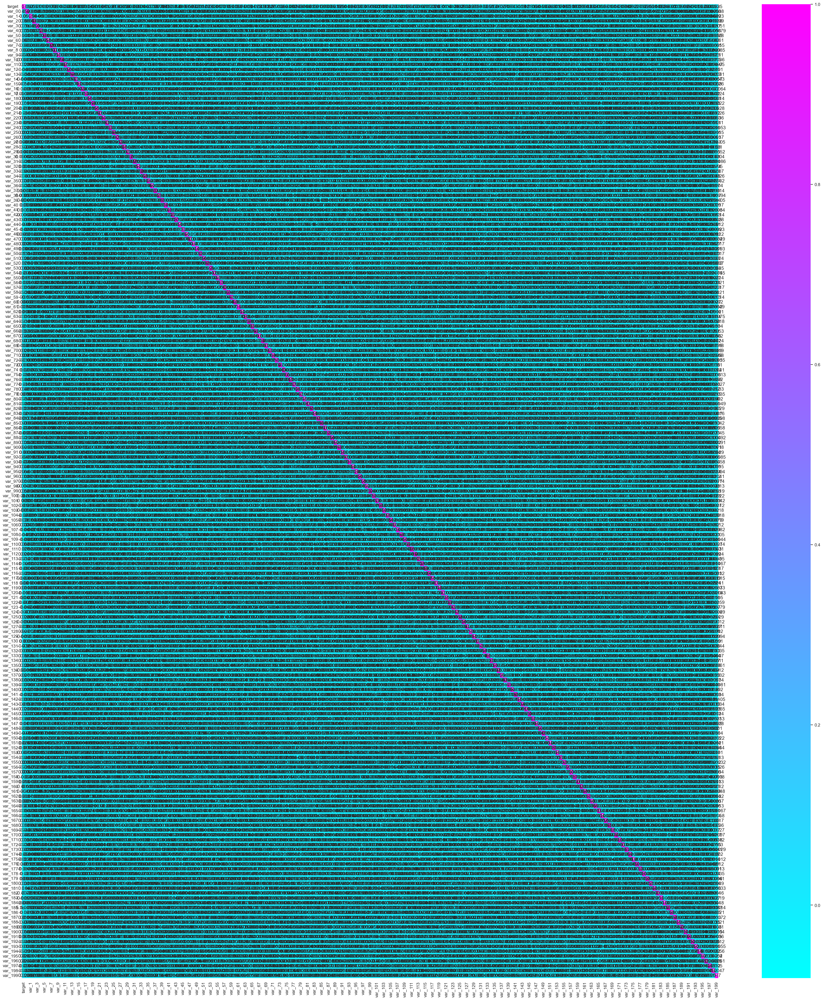

In [31]:
# Plot hitmap for better visualisation
plt.figure(figsize=(40,45))
sns.heatmap(df.corr(),annot=True,cmap='cool')
plt.show()

## Insights
* From above heatmap scale we cannot clearly see the highly correlated feature in data
* So we confirm with the help of python code

In [32]:
import pandas as pd

# Calculate correlation matrix and filter highly correlated features
pd.set_option('display.max_rows', None)
corr = df.corr().abs().unstack()
high_corr = corr[(corr >= 0.9) & (corr < 1)].sort_values(ascending=False)

# Convert to DataFrame
high_corr_df = high_corr.reset_index()
high_corr_df.columns = ['Feature 1', 'Feature 2', 'Correlation']
high_corr_df


,Feature 1,Feature 2,Correlation


## Insights
* Their is no highly correlated feature in dataset

### 3.CHECKING DUPLICATES

In [33]:
df.duplicated().sum()

0

* Their is no duplicates avialable on data

### 4.PRINCIPLE COMPONENT ANALYSIS

* Reduce the feature with the help of pca as there is more features in the dataset even after data preprocessing and it will be dificulty to learn model and train it so we are using PCA technique to manage features.

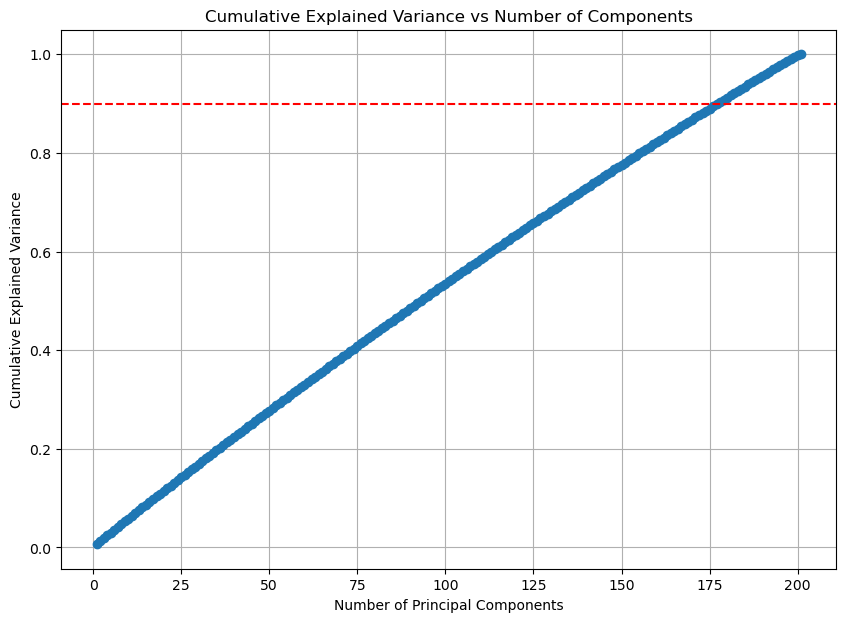

Optimal number of components to explain 90% variance: 178


In [9]:
# Getting the optimal value of pca
from sklearn.decomposition import PCA
pca = PCA()
principlecomponent = pca.fit_transform(df) # Fit PCA on the scaled training data
# Step 3: Calculate explained variance ratio
explained_variance = pca.explained_variance_ratio_

# Step 4: Plot the cumulative explained variance
cumulative_variance = np.cumsum(explained_variance)

plt.figure(figsize=(10, 7))
plt.plot(range(1, len(cumulative_variance) + 1), cumulative_variance, marker='o', linestyle='--')
plt.title('Cumulative Explained Variance vs Number of Components')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.grid(True)
plt.axhline(y=0.90, color='r', linestyle='--')  # 90% variance threshold
plt.show()

# Step 5: Find the optimal number of components (e.g., 90% variance)
optimal_components = np.argmax(cumulative_variance >= 0.90) + 1
print(f'Optimal number of components to explain 90% variance: {optimal_components}')

## Insights
* In this plot we cleary seen the line of no of components is straight means the feature is more important so we are going to select 178 feature because of less variance loss

In [10]:
# Selecting the components
pca = PCA(n_components=178)
new_data=pca.fit_transform(df)
new_data

array([[ 0.51758867,  0.26955976,  0.05402251, ..., -0.11513663,
         0.21883297, -0.25457851],
       [-1.32400732, -0.53357927,  1.95817087, ..., -0.92232568,
         0.4281935 , -0.4807521 ],
       [ 0.04224386, -0.81522866, -0.3257926 , ...,  0.06298591,
         0.61573739, -1.06804533],
       ...,
       [-0.01423866,  0.55522966,  0.65142503, ..., -0.39579092,
         0.73713304, -0.7372401 ],
       [ 0.40689894,  0.23820526,  0.38221209, ...,  1.33085723,
        -1.24060483,  0.06415085],
       [ 0.76575485, -0.16503883,  0.39951196, ..., -0.38939322,
        -0.47230532,  0.33852352]])

Explained variance by 178 components: 0.9032257790113785


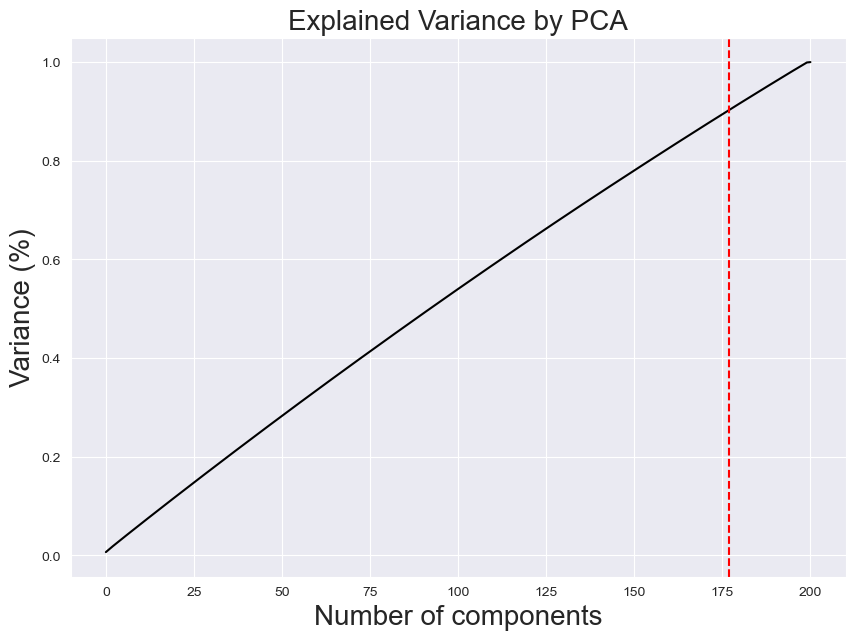

In [11]:
# Step 6: Optionally, check the explained variance for the selected components
print(f'Explained variance by {optimal_components} components: {np.sum(pca.explained_variance_ratio_)}')

# Step 7: Plot the cumulative explained variance (for visualization)
plt.figure(figsize=(10, 7))
sns.set_style('darkgrid')
plt.plot(cumulative_variance, color='k')
plt.xlabel('Number of components', fontsize=20)
plt.ylabel('Variance (%)', fontsize=20)
plt.title('Explained Variance by PCA', fontsize=20)
plt.axvline(x=optimal_components-1, color='r', linestyle='--')  # Mark optimal components
plt.show()

In [12]:
import pandas as pd

# Assuming `new_data` contains the PCA-transformed data
# You can dynamically generate the column names based on the number of PCA components

# For example, if you have 175 PCA components
num_components = 178
column_names = [f'pca{i+1}' for i in range(num_components)]

# Create a new DataFrame with the transformed data and dynamically generated column names
principle_df = pd.DataFrame(data=new_data, columns=column_names)

# Display the first few rows of the new DataFrame
principle_df.head()


,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,pca11,pca12,pca13,pca14,pca15,pca16,pca17,pca18,pca19,pca20,pca21,pca22,pca23,pca24,pca25,pca26,pca27,pca28,pca29,pca30,pca31,pca32,pca33,pca34,pca35,pca36,pca37,pca38,pca39,pca40,pca41,pca42,pca43,pca44,pca45,pca46,pca47,pca48,pca49,pca50,pca51,pca52,pca53,pca54,pca55,pca56,pca57,pca58,pca59,pca60,pca61,pca62,pca63,pca64,pca65,pca66,pca67,pca68,pca69,pca70,pca71,pca72,pca73,pca74,pca75,pca76,pca77,pca78,pca79,pca80,pca81,pca82,pca83,pca84,pca85,pca86,pca87,pca88,pca89,pca90,pca91,pca92,pca93,pca94,pca95,pca96,pca97,pca98,pca99,pca100,pca101,pca102,pca103,pca104,pca105,pca106,pca107,pca108,pca109,pca110,pca111,pca112,pca113,pca114,pca115,pca116,pca117,pca118,pca119,pca120,pca121,pca122,pca123,pca124,pca125,pca126,pca127,pca128,pca129,pca130,pca131,pca132,pca133,pca134,pca135,pca136,pca137,pca138,pca139,pca140,pca141,pca142,pca143,pca144,pca145,pca146,pca147,pca148,pca149,pca150,pca151,pca152,pca153,pca154,pca155,pca156,pca157,pca158,pca159,pca160,pca161,pca162,pca163,pca164,pca165,pca166,pca167,pca168,pca169,pca170,pca171,pca172,pca173,pca174,pca175,pca176,pca177,pca178
0,0.517589,0.269560,0.054023,-0.369893,0.835381,0.662795,1.319730,1.064223,-0.849499,0.433281,0.099748,0.189458,0.036275,0.666101,-0.022342,-0.761547,-0.166639,0.030342,-0.068087,1.435869,0.548179,1.059613,-1.190722,-0.729638,-0.071145,0.078544,-0.887911,-0.807112,0.012292,-0.763784,-0.274470,-0.372900,-0.263387,-0.002814,-0.656367,-0.047525,0.682693,0.054722,0.088106,0.400059,0.216680,-0.921100,0.608908,0.340632,0.704269,-0.170687,-0.654300,1.061424,-0.483177,1.065057,-1.490633,0.388312,-0.253202,0.513145,1.014501,-0.233567,-0.107051,-0.773744,0.066686,-0.477828,0.881100,0.525298,1.033929,0.201180,-0.691202,-0.487673,0.445280,-0.124135,-1.776024,-0.074610,-0.685690,0.032297,0.050818,0.034366,0.397986,-1.170827,0.368282,0.595141,1.006387,-0.382024,-0.535029,-0.493931,0.756615,0.714640,0.164489,0.506951,0.682040,-0.319673,1.048802,0.270264,0.624894,0.068417,-0.701790,0.475613,-0.198829,-0.755601,0.329829,-0.150092,1.165510,-1.094786,0.607245,0.807198,0.182657,0.224932,-1.100740,0.356435,0.452096,0.107081,-0.001502,1.180537,-0.631718,-0.756883,-1.088512,-0.304309,-0.186437,0.176686,-0.926008,-0.804948,0.792421,-1.048378,-0.797376,1.107738,0.291139,-0.053988,-1.002628,0.755661,-0.211778,0.234515,0.266976,-0.328136,0.648342,0.498883,0.522072,0.584286,-0.637994,0.123388,-0.333348,1.680633,0.620728,-0.031284,0.976753,-0.287220,0.397111,-0.959304,0.769188,-0.401486,-0.294892,-0.331451,0.103151,-1.979216,0.167794,-0.214290,0.403365,-0.544890,0.547660,-0.513307,-0.598169,-0.702461,-0.554514,-0.282646,0.129703,-1.053936,-0.667963,-0.169669,-1.219645,-0.554410,-0.611039,1.112001,-0.258308,-0.751815,0.967646,-0.750007,-0.911975,0.028257,-0.018238,-0.115137,0.218833,-0.254579
1,-1.324007,-0.533579,1.958171,1.308587,0.328150,0.049564,-1.179654,0.139923,0.443926,0.601061,0.507448,0.290780,-2.031748,-1.611884,-0.508465,0.886412,-0.154350,-0.436477,-0.736805,-0.529373,1.095882,-0.959536,1.069778,1.143183,2.077901,-0.579774,1.045354,0.939488,0.376925,0.163353,0.055867,-0.105673,0.970089,0.221928,0.833694,1.083230,-0.575362,1.052924,-0.173764,-0.949257,-0.279215,-0.698407,0.107007,-0.484972,-1.349184,0.738426,-0.073452,-0.602862,0.583670,-0.220609,0.306837,-0.204201,-0.228406,0.633989,-0.153384,0.466705,-0.628820,-0.603458,-1.086874,1.179418,0.334649,0.610178,-0.116334,0.111064,-0.683004,1.137632,-0.223746,-0.423983,0.800753,0.838010,-0.190419,-0.771438,0.256354,0.129691,-0.351200,0.497553,-1.241447,-0.499981,0.798423,-0.622427,-0.289117,0.650573,-0.136576,0.584297,0.110860,0.206038,0.438245,-0.541694,0.912810,0.077358,0.330347,1.128143,0.679547,-0.558082,0.370086,0.233700,-0.451091,0.351500,0.282666,1.002136,0.024931,1.136643,-0.046010,-0.513514,1.083092,1.365194,0.171206,0.028797,-0.311181,0.808733,0.251169,-0.152583,0.291193,-0.772977,0.671171,1.461625,0.492782,-0.479170,0.949655,0.332061,-0.031731,-0.234562,0.318108,-1.34899

### MODEL CREATION

### HERE WE WILL BE EXPERIMENTING WITH SIX ALGORITHM

- 1. Logistic Regression
- 2.  Random Forest Classifier
- 3. Artificial Neural Network [MLP Classifier]
- 4. Knearest Neighbour Classifier
- 5. Decision Tree Classifier
- In customer transaction prediction f1 score metrix is important so we need more focus to improve f1 score 

#### DEFINE INDEPENDANT AND DEPENDANT VERIABLE`

In [13]:
X = principle_df
y = df.target

In [14]:
X.head()

,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,pca11,pca12,pca13,pca14,pca15,pca16,pca17,pca18,pca19,pca20,pca21,pca22,pca23,pca24,pca25,pca26,pca27,pca28,pca29,pca30,pca31,pca32,pca33,pca34,pca35,pca36,pca37,pca38,pca39,pca40,pca41,pca42,pca43,pca44,pca45,pca46,pca47,pca48,pca49,pca50,pca51,pca52,pca53,pca54,pca55,pca56,pca57,pca58,pca59,pca60,pca61,pca62,pca63,pca64,pca65,pca66,pca67,pca68,pca69,pca70,pca71,pca72,pca73,pca74,pca75,pca76,pca77,pca78,pca79,pca80,pca81,pca82,pca83,pca84,pca85,pca86,pca87,pca88,pca89,pca90,pca91,pca92,pca93,pca94,pca95,pca96,pca97,pca98,pca99,pca100,pca101,pca102,pca103,pca104,pca105,pca106,pca107,pca108,pca109,pca110,pca111,pca112,pca113,pca114,pca115,pca116,pca117,pca118,pca119,pca120,pca121,pca122,pca123,pca124,pca125,pca126,pca127,pca128,pca129,pca130,pca131,pca132,pca133,pca134,pca135,pca136,pca137,pca138,pca139,pca140,pca141,pca142,pca143,pca144,pca145,pca146,pca147,pca148,pca149,pca150,pca151,pca152,pca153,pca154,pca155,pca156,pca157,pca158,pca159,pca160,pca161,pca162,pca163,pca164,pca165,pca166,pca167,pca168,pca169,pca170,pca171,pca172,pca173,pca174,pca175,pca176,pca177,pca178
0,0.517589,0.269560,0.054023,-0.369893,0.835381,0.662795,1.319730,1.064223,-0.849499,0.433281,0.099748,0.189458,0.036275,0.666101,-0.022342,-0.761547,-0.166639,0.030342,-0.068087,1.435869,0.548179,1.059613,-1.190722,-0.729638,-0.071145,0.078544,-0.887911,-0.807112,0.012292,-0.763784,-0.274470,-0.372900,-0.263387,-0.002814,-0.656367,-0.047525,0.682693,0.054722,0.088106,0.400059,0.216680,-0.921100,0.608908,0.340632,0.704269,-0.170687,-0.654300,1.061424,-0.483177,1.065057,-1.490633,0.388312,-0.253202,0.513145,1.014501,-0.233567,-0.107051,-0.773744,0.066686,-0.477828,0.881100,0.525298,1.033929,0.201180,-0.691202,-0.487673,0.445280,-0.124135,-1.776024,-0.074610,-0.685690,0.032297,0.050818,0.034366,0.397986,-1.170827,0.368282,0.595141,1.006387,-0.382024,-0.535029,-0.493931,0.756615,0.714640,0.164489,0.506951,0.682040,-0.319673,1.048802,0.270264,0.624894,0.068417,-0.701790,0.475613,-0.198829,-0.755601,0.329829,-0.150092,1.165510,-1.094786,0.607245,0.807198,0.182657,0.224932,-1.100740,0.356435,0.452096,0.107081,-0.001502,1.180537,-0.631718,-0.756883,-1.088512,-0.304309,-0.186437,0.176686,-0.926008,-0.804948,0.792421,-1.048378,-0.797376,1.107738,0.291139,-0.053988,-1.002628,0.755661,-0.211778,0.234515,0.266976,-0.328136,0.648342,0.498883,0.522072,0.584286,-0.637994,0.123388,-0.333348,1.680633,0.620728,-0.031284,0.976753,-0.287220,0.397111,-0.959304,0.769188,-0.401486,-0.294892,-0.331451,0.103151,-1.979216,0.167794,-0.214290,0.403365,-0.544890,0.547660,-0.513307,-0.598169,-0.702461,-0.554514,-0.282646,0.129703,-1.053936,-0.667963,-0.169669,-1.219645,-0.554410,-0.611039,1.112001,-0.258308,-0.751815,0.967646,-0.750007,-0.911975,0.028257,-0.018238,-0.115137,0.218833,-0.254579
1,-1.324007,-0.533579,1.958171,1.308587,0.328150,0.049564,-1.179654,0.139923,0.443926,0.601061,0.507448,0.290780,-2.031748,-1.611884,-0.508465,0.886412,-0.154350,-0.436477,-0.736805,-0.529373,1.095882,-0.959536,1.069778,1.143183,2.077901,-0.579774,1.045354,0.939488,0.376925,0.163353,0.055867,-0.105673,0.970089,0.221928,0.833694,1.083230,-0.575362,1.052924,-0.173764,-0.949257,-0.279215,-0.698407,0.107007,-0.484972,-1.349184,0.738426,-0.073452,-0.602862,0.583670,-0.220609,0.306837,-0.204201,-0.228406,0.633989,-0.153384,0.466705,-0.628820,-0.603458,-1.086874,1.179418,0.334649,0.610178,-0.116334,0.111064,-0.683004,1.137632,-0.223746,-0.423983,0.800753,0.838010,-0.190419,-0.771438,0.256354,0.129691,-0.351200,0.497553,-1.241447,-0.499981,0.798423,-0.622427,-0.289117,0.650573,-0.136576,0.584297,0.110860,0.206038,0.438245,-0.541694,0.912810,0.077358,0.330347,1.128143,0.679547,-0.558082,0.370086,0.233700,-0.451091,0.351500,0.282666,1.002136,0.024931,1.136643,-0.046010,-0.513514,1.083092,1.365194,0.171206,0.028797,-0.311181,0.808733,0.251169,-0.152583,0.291193,-0.772977,0.671171,1.461625,0.492782,-0.479170,0.949655,0.332061,-0.031731,-0.234562,0.318108,-1.34899

In [40]:
y.head()

0    0
1    0
2    0
3    0
4    0
Name: target, dtype: int64

#### BALANCING THE TARGET COLUMN USING SMOTE

In [15]:
smote = SMOTE(random_state=42)  # Initialize SMOTE
X_balanced, y_balanced = smote.fit_resample(X, y)  # 
# Step 5: Check the class distribution after SMOTE
print(f'Original class distribution in y_train: {y.value_counts()}')
print(f'Balanced class distribution in y_train: {pd.Series(y_balanced).value_counts()}')


Original class distribution in y_train: target
0    179902
1     20098
Name: count, dtype: int64
Balanced class distribution in y_train: target
0    179902
1    179902
Name: count, dtype: int64


#### SHOWING BALANCED DATA BY GRAPH

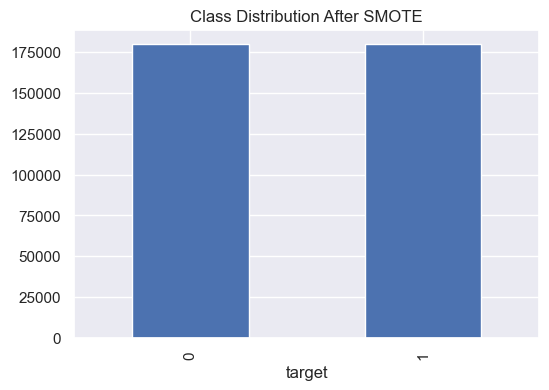

In [42]:
import matplotlib.pyplot as plt
plt.figure(figsize=(6,4))
pd.Series(y_balanced).value_counts().plot(kind='bar', title='Class Distribution After SMOTE')
plt.show()

#### SPLIT TRAINING AND TESTING DATA

In [16]:
from sklearn.model_selection import train_test_split
X_train,X_test,y_train,y_test=train_test_split(X_balanced,y_balanced,random_state=42,test_size=0.30) 
# 30% data given to testing because the large amount of data

In [17]:
# Check shape of train and test
X_train.shape

(251862, 178)

In [18]:
X_test.shape

(107942, 178)

In [19]:
y_train.shape

(251862,)

In [20]:
y_test.shape

(107942,)

In [21]:
from collections import Counter
from imblearn.over_sampling import SMOTE
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix, accuracy_score ,recall_score # Import required metrics

### 1.LOGISTIC REGRESSION

In [49]:
#Train a Logistic Regression model
log_reg = LogisticRegression(random_state=42)  # Create Logistic Regression object
log_reg.fit(X_train, y_train)  # Fit the model on resampled data

LogisticRegression(random_state=42)

In [50]:
# Step 6: Make predictions on the test set
y_pred_test = log_reg.predict(X_test)  # Predict on the test data
y_pred_train=log_reg.predict(X_train) #Predict on the train data

#### EVALUATION

In [51]:
# Print accuracy score
log_test_accuracy = accuracy_score(y_pred_test, y_test)
log_train_accuracy=accuracy_score(y_pred_train,y_train)

print("Testing accuracy of Logistic regression model",log_test_accuracy)
print("Training accuracy of Logistic regression model",log_train_accuracy)
print("Logistic regression training Classification report: \n",classification_report(y_pred_test,y_test))

# Print confusion matrix for a more detailed evaluation
print("Confusion Matrix:")
print(confusion_matrix(y_pred_test,y_test))

Testing accuracy of Logistic regression model 0.8362546552778344
Training accuracy of Logistic regression model 0.8361404261063599
Logistic regression training Classification report: 
               precision    recall  f1-score   support

           0       0.83      0.84      0.84     53201
           1       0.84      0.83      0.84     54741

    accuracy                           0.84    107942
   macro avg       0.84      0.84      0.84    107942
weighted avg       0.84      0.84      0.84    107942

Confusion Matrix:
[[44762  8439]
 [ 9236 45505]]


In [52]:
log_f1_score_test = recall_score(y_pred_test,y_test)
print('F1 log test Score',log_f1_score_test*100)

F1 log test Score 83.12782009828099


In [53]:
log_f1_score_train = recall_score(y_pred_train,y_train)
print('F1 log train Score',log_f1_score_train*100)

F1 log train Score 83.08383467458395


## Insights:
The Logistic Regression model demonstrates solid performance with testing and training accuracy both around 83%. The F1 scores are also strong, with the test F1 score at 83.12% and the train F1 score at 83.08%, highlighting balanced precision and recall. However, there's potential to improve the model's performance further.

### 2.RANDOM FOREST CLASSIFIER

In [38]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier  # Example model

# Step 4: Initialize and train a model (e.g., RandomForestClassifier)
RF = RandomForestClassifier()
RF.fit(X_train, y_train)

RandomForestClassifier()

In [39]:
# Step 5: Make predictions and evaluate the model
y_pred = RF.predict(X_test)
y_pred_train=RF.predict(X_train)

#### EVALUATION

In [40]:

RF_test_accuracy = accuracy_score(y_pred, y_test)
RF_train_accuracy=accuracy_score(y_pred_train,y_train)

print("Testing accuracy of Random Forest Classifier regression model",RF_test_accuracy)
print("Training accuracy of Random Forest Classifier model",RF_train_accuracy)
print("Logistic regression training Classification report: \n",classification_report(y_pred,y_test))

# Print confusion matrix for a more detailed evaluation
print("Confusion Matrix:")
print(confusion_matrix(y_pred,y_test))

Testing accuracy of Random Forest Classifier regression model 0.9266272627892758
Training accuracy of Random Forest Classifier model 1.0
Logistic regression training Classification report: 
               precision    recall  f1-score   support

           0       0.92      0.94      0.93     52782
           1       0.94      0.92      0.93     55160

    accuracy                           0.93    107942
   macro avg       0.93      0.93      0.93    107942
weighted avg       0.93      0.93      0.93    107942

Confusion Matrix:
[[49430  3352]
 [ 4568 50592]]


In [41]:
RF_f1_score_test = recall_score(y_pred,y_test)
print('F1 RF test Score',RF_f1_score_test*100)

F1 RF test Score 91.71863669325599


In [42]:
RF_f1_score_train = recall_score(y_pred_train,y_train)
print('F1 RF train Score',RF_f1_score_train*100)

F1 RF train Score 100.0


## Insights:
The Random Forest model performs exceptionally well, with a high testing accuracy of 92.6% and perfect training accuracy (1.0), indicating potential overfitting. The F1 score for the test data is strong at 91.6%, reflecting a good balance between precision and recall, while the training F1 score (82.3%) suggests it may have memorized the training set.

## 3.ANN [MLP Classifier]

In [22]:
# Step:1 Importing library and object creation
from sklearn.neural_network import MLPClassifier
# Step:1 Importing library and object creation
from sklearn.neural_network import MLPClassifier
Ann= MLPClassifier(hidden_layer_sizes=(60,3),
                      learning_rate='constant',
                      max_iter=100,
                      random_state=42)
# Step:2 Fitting the training data
Ann.fit(X_train,y_train)

MLPClassifier(hidden_layer_sizes=(60, 3), max_iter=100, random_state=42)

In [23]:
# Step:3 Predicting the probability
mlp_prdict_probability = Ann.predict_proba(X_test)
mlp_prdict_probability

array([[9.99983232e-01, 1.67680712e-05],
       [1.52402973e-03, 9.98475970e-01],
       [4.83478624e-03, 9.95165214e-01],
       ...,
       [5.64913462e-04, 9.99435087e-01],
       [6.23515303e-01, 3.76484697e-01],
       [9.95662171e-01, 4.33782921e-03]])

In [24]:
# Step:4 Prediction on test data
mlp_test_predict = Ann.predict(X_test)

# Step:5 Prediction on training data
mlp_train_predict = Ann.predict(X_train)

#### EVALUATION

In [25]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

mlp_test_accuracy = accuracy_score(mlp_test_predict,y_test)
mlp_train_accuracy=accuracy_score(mlp_train_predict,y_train)

print("Testing accuracy of MLP model is:",mlp_test_accuracy)
print("Training accuracy of MLP model is:",mlp_train_accuracy)

print("Confusion Matrix:")
print(confusion_matrix(mlp_test_predict,y_test ))
print("Classification report of testing:"'\n',classification_report(mlp_test_predict,y_test))

Testing accuracy of MLP model is: 0.9024568749884198
Training accuracy of MLP model is: 0.9382876337041713
Confusion Matrix:
[[48265  4796]
 [ 5733 49148]]
Classification report of testing:
               precision    recall  f1-score   support

           0       0.89      0.91      0.90     53061
           1       0.91      0.90      0.90     54881

    accuracy                           0.90    107942
   macro avg       0.90      0.90      0.90    107942
weighted avg       0.90      0.90      0.90    107942



In [26]:
mlp_f1_score_test = f1_score(mlp_test_predict,y_test)
print('F1 mlp test Score',mlp_f1_score_test*100)

F1 mlp test Score 90.32483344819666


In [27]:
mlp_f1_score_train = recall_score(mlp_train_predict,y_train)
print('F1 mlp train Score',mlp_f1_score_train*100)

F1 mlp train Score 93.72559579911135


* ANN MLP classifier model testing accuracy also good.
* The MLP model demonstrates strong performance, with a testing accuracy of 90.2% and a training accuracy of 93.8%. The F1 score of 90.3% on the test set reflects a balanced and effective prediction for both classes, confirming its suitability for the task at hand. The classification report and confusion matrix indicate consistent performance across both classes.
* we choosed this for final model prediction

### 4.K-NEAREST NEIGHBORS (KNN) CLASSIFIER

In [33]:
from sklearn.neighbors import KNeighborsClassifier

knn = KNeighborsClassifier()
knn.fit(X_train, y_train)

KNeighborsClassifier()

In [34]:
y_pred_test= knn.predict(X_test)
y_pred_train= knn.predict(X_train)

#### EVALUATION

In [35]:
from sklearn.metrics import accuracy_score
knn_test_accuracy = accuracy_score(y_pred_test,y_test)
knn_train_accuracy=accuracy_score(y_pred_train,y_train)

print("Testing accuracy of Knn model is:",knn_test_accuracy)
print("Training accuracy of Knn model is:",knn_train_accuracy)

print("Confusion Matrix:")
print(confusion_matrix(y_pred_test,y_test ))
print("Classification report of testing:"'\n',classification_report(y_pred_test,y_test))

Testing accuracy of Knn model is: 0.4997591299030961
Training accuracy of Knn model is: 0.5004129245380406
Confusion Matrix:
[[    1     0]
 [53997 53944]]
Classification report of testing:
               precision    recall  f1-score   support

           0       0.00      1.00      0.00         1
           1       1.00      0.50      0.67    107941

    accuracy                           0.50    107942
   macro avg       0.50      0.75      0.33    107942
weighted avg       1.00      0.50      0.67    107942



In [36]:
knn_f1_score = f1_score(y_pred_test,y_test)
print("F1 score of test knn :",knn_f1_score*100)

F1 score of test knn : 66.6448404731754


In [37]:
knn_f1_score_train = recall_score(y_pred_train,y_train)
print('F1 knn train Score',knn_f1_score_train*100)

F1 knn train Score 50.02601425819647


## Insights
The KNN model shows poor performance with a testing accuracy of just 50%, and the classification report indicates a significant imbalance, where it struggles to predict class 0 correctly. Despite a decent F1 score of 83.1% on the test set, it fails to capture both classes effectively, making it unsuitable for this task.

### 5.DECISION TREE CLASSIFIER

In [28]:
from sklearn.tree import DecisionTreeClassifier

dtc = DecisionTreeClassifier()
dt=DecisionTreeClassifier(max_depth=10, random_state=2)
dt.fit(X_train,y_train)

DecisionTreeClassifier(max_depth=10, random_state=2)

In [29]:
y_pred_test= dt.predict(X_test)
y_pred_train= dt.predict(X_train)

#### EVALUATION

In [30]:
from sklearn.metrics import accuracy_score
dt_test_accuracy = accuracy_score(y_pred_test,y_test)
dt_train_accuracy=accuracy_score(y_pred_train,y_train)

print("Testing accuracy of DT model is:",dt_test_accuracy)
print("Training accuracy of DT model is:",dt_train_accuracy)

print("Confusion Matrix:")
print(confusion_matrix(y_pred_test,y_test ))
print("Classification report of testing:"'\n',classification_report(y_pred_test,y_test))

Testing accuracy of DT model is: 0.8253877082136704
Training accuracy of DT model is: 0.8425050225917368
Confusion Matrix:
[[42859  7709]
 [11139 46235]]
Classification report of testing:
               precision    recall  f1-score   support

           0       0.79      0.85      0.82     50568
           1       0.86      0.81      0.83     57374

    accuracy                           0.83    107942
   macro avg       0.83      0.83      0.83    107942
weighted avg       0.83      0.83      0.83    107942



In [31]:
dt_f1_score = f1_score(y_pred_test,y_test)
print("F1 score of test DT:",dt_f1_score*100)

F1 score of test DT: 83.06832677554394


In [32]:
dt_f1_score_train = recall_score(y_pred_train,y_train)
print('F1 dt train Score',dt_f1_score_train*100)

F1 dt train Score 82.2604885562393


## Insights 
The Decision Tree model has decent performance with a testing accuracy of 82.5%, but it struggles with classifying both classes effectively, as seen in the confusion matrix. The F1 score of 83.1% on the test set is okay, but it still has room for improvement, especially in balancing precision and recall.

### Create a DataFrame for Training And testing model comparison

In [43]:
# Create a DataFrame for model comparison
models_comparison = {
    "Model": ["Logistic Regression","Random Forest Classification ","ANN [MLP Classifier]",
              "KNN Classifier","Decision Tree Classifier",],
    "Train F1 Score": [83.08, 91.58, 90.32,83.06,83.06],
    "Test F1 Score": [ 83.12, 82.26, 93.72,82.26,82.26]
}

# Convert dictionary to a DataFrame
metrics_df = pd.DataFrame(models_comparison)

# Display the table
metrics_df

,Model,Train F1 Score,Test F1 Score
0,Logistic Regression,83.08,83.12
1,Random Forest Classification,91.58,82.26
2,ANN [MLP Classifier],90.32,93.72
3,KNN Classifier,83.06,82.26
4,Decision Tree Classifier,83.06,82.26


## Insights:
From above 
- The ANN models performed the best with high F1 scores on both training and testing sets. Although Random Forest performed well on training data, its test F1 score dropped, showing it might not generalize as well.
- We chose ANN for its consistent performance across both training and test data with a good balance in precision and recall.

# Insights:

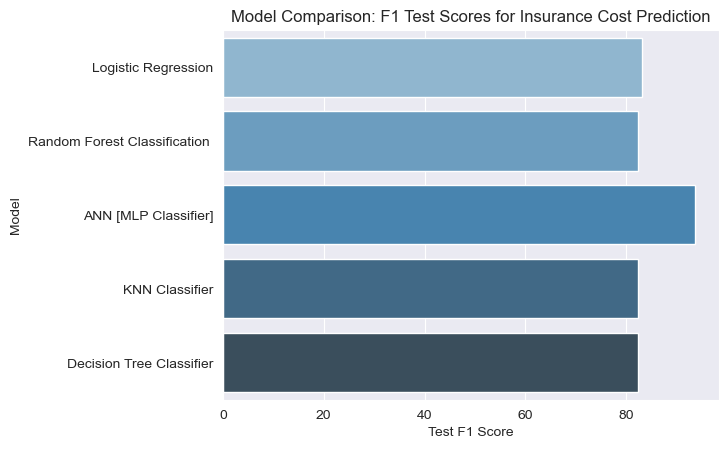

In [44]:
import seaborn as sns
import matplotlib.pyplot as plt

sns.barplot(x="Test F1 Score", y="Model", data=metrics_df, palette="Blues_d")
plt.title("Model Comparison: F1 Test Scores for Insurance Cost Prediction")
plt.show()

## Insights:
- As we can visualized from above barplot Ann has excellent F1 score
- we are choosing Ann Model for Future Prediction or deployment 

#### SAVE AND LOAD MODEL

In [45]:
import pickle

filename = 'Customer_Transaction_Prediction_Project.pkl'

# Save the model to a file
with open(filename, 'wb') as f:
    pickle.dump(Ann,f)
print("Model saved successfully!")

Model saved successfully!


#### LOADING MODEL

In [46]:
# Load the saved model
with open(filename, 'rb') as f:
    loaded_model = pickle.load(f)

# Use the loaded model to make predictions
predictions = loaded_model.predict(X_test)
print(predictions)


[0 1 1 ... 1 0 0]


In [47]:
principle_df.head()

,pca1,pca2,pca3,pca4,pca5,pca6,pca7,pca8,pca9,pca10,pca11,pca12,pca13,pca14,pca15,pca16,pca17,pca18,pca19,pca20,pca21,pca22,pca23,pca24,pca25,pca26,pca27,pca28,pca29,pca30,pca31,pca32,pca33,pca34,pca35,pca36,pca37,pca38,pca39,pca40,pca41,pca42,pca43,pca44,pca45,pca46,pca47,pca48,pca49,pca50,pca51,pca52,pca53,pca54,pca55,pca56,pca57,pca58,pca59,pca60,pca61,pca62,pca63,pca64,pca65,pca66,pca67,pca68,pca69,pca70,pca71,pca72,pca73,pca74,pca75,pca76,pca77,pca78,pca79,pca80,pca81,pca82,pca83,pca84,pca85,pca86,pca87,pca88,pca89,pca90,pca91,pca92,pca93,pca94,pca95,pca96,pca97,pca98,pca99,pca100,pca101,pca102,pca103,pca104,pca105,pca106,pca107,pca108,pca109,pca110,pca111,pca112,pca113,pca114,pca115,pca116,pca117,pca118,pca119,pca120,pca121,pca122,pca123,pca124,pca125,pca126,pca127,pca128,pca129,pca130,pca131,pca132,pca133,pca134,pca135,pca136,pca137,pca138,pca139,pca140,pca141,pca142,pca143,pca144,pca145,pca146,pca147,pca148,pca149,pca150,pca151,pca152,pca153,pca154,pca155,pca156,pca157,pca158,pca159,pca160,pca161,pca162,pca163,pca164,pca165,pca166,pca167,pca168,pca169,pca170,pca171,pca172,pca173,pca174,pca175,pca176,pca177,pca178
0,0.517589,0.269560,0.054023,-0.369893,0.835381,0.662795,1.319730,1.064223,-0.849499,0.433281,0.099748,0.189458,0.036275,0.666101,-0.022342,-0.761547,-0.166639,0.030342,-0.068087,1.435869,0.548179,1.059613,-1.190722,-0.729638,-0.071145,0.078544,-0.887911,-0.807112,0.012292,-0.763784,-0.274470,-0.372900,-0.263387,-0.002814,-0.656367,-0.047525,0.682693,0.054722,0.088106,0.400059,0.216680,-0.921100,0.608908,0.340632,0.704269,-0.170687,-0.654300,1.061424,-0.483177,1.065057,-1.490633,0.388312,-0.253202,0.513145,1.014501,-0.233567,-0.107051,-0.773744,0.066686,-0.477828,0.881100,0.525298,1.033929,0.201180,-0.691202,-0.487673,0.445280,-0.124135,-1.776024,-0.074610,-0.685690,0.032297,0.050818,0.034366,0.397986,-1.170827,0.368282,0.595141,1.006387,-0.382024,-0.535029,-0.493931,0.756615,0.714640,0.164489,0.506951,0.682040,-0.319673,1.048802,0.270264,0.624894,0.068417,-0.701790,0.475613,-0.198829,-0.755601,0.329829,-0.150092,1.165510,-1.094786,0.607245,0.807198,0.182657,0.224932,-1.100740,0.356435,0.452096,0.107081,-0.001502,1.180537,-0.631718,-0.756883,-1.088512,-0.304309,-0.186437,0.176686,-0.926008,-0.804948,0.792421,-1.048378,-0.797376,1.107738,0.291139,-0.053988,-1.002628,0.755661,-0.211778,0.234515,0.266976,-0.328136,0.648342,0.498883,0.522072,0.584286,-0.637994,0.123388,-0.333348,1.680633,0.620728,-0.031284,0.976753,-0.287220,0.397111,-0.959304,0.769188,-0.401486,-0.294892,-0.331451,0.103151,-1.979216,0.167794,-0.214290,0.403365,-0.544890,0.547660,-0.513307,-0.598169,-0.702461,-0.554514,-0.282646,0.129703,-1.053936,-0.667963,-0.169669,-1.219645,-0.554410,-0.611039,1.112001,-0.258308,-0.751815,0.967646,-0.750007,-0.911975,0.028257,-0.018238,-0.115137,0.218833,-0.254579
1,-1.324007,-0.533579,1.958171,1.308587,0.328150,0.049564,-1.179654,0.139923,0.443926,0.601061,0.507448,0.290780,-2.031748,-1.611884,-0.508465,0.886412,-0.154350,-0.436477,-0.736805,-0.529373,1.095882,-0.959536,1.069778,1.143183,2.077901,-0.579774,1.045354,0.939488,0.376925,0.163353,0.055867,-0.105673,0.970089,0.221928,0.833694,1.083230,-0.575362,1.052924,-0.173764,-0.949257,-0.279215,-0.698407,0.107007,-0.484972,-1.349184,0.738426,-0.073452,-0.602862,0.583670,-0.220609,0.306837,-0.204201,-0.228406,0.633989,-0.153384,0.466705,-0.628820,-0.603458,-1.086874,1.179418,0.334649,0.610178,-0.116334,0.111064,-0.683004,1.137632,-0.223746,-0.423983,0.800753,0.838010,-0.190419,-0.771438,0.256354,0.129691,-0.351200,0.497553,-1.241447,-0.499981,0.798423,-0.622427,-0.289117,0.650573,-0.136576,0.584297,0.110860,0.206038,0.438245,-0.541694,0.912810,0.077358,0.330347,1.128143,0.679547,-0.558082,0.370086,0.233700,-0.451091,0.351500,0.282666,1.002136,0.024931,1.136643,-0.046010,-0.513514,1.083092,1.365194,0.171206,0.028797,-0.311181,0.808733,0.251169,-0.152583,0.291193,-0.772977,0.671171,1.461625,0.492782,-0.479170,0.949655,0.332061,-0.031731,-0.234562,0.318108,-1.34899

#### MAKING PREDICTION

In [48]:
input_data = np.array([0.517589, 0.269560, 0.054023, -0.369893, 0.835381, 0.662795, 1.319730, 1.064223, -0.849499, 0.433281, 0.099748, 0.189458, 0.036275, 0.666101, -0.022342, -0.761547, -0.166639, 0.030342, -0.068087, 1.435869, 0.548179, 1.059613, -1.190722, -0.729638, -0.071145, 0.078544, -0.887911, -0.807112, 0.012292, -0.763784, -0.274470, -0.372900, -0.263387, -0.002814, -0.656367, -0.047525, 0.682693, 0.054722, 0.088106, 0.400059, 0.216680, -0.921100, 0.608908, 0.340632, 0.704269, -0.170687, -0.654300, 1.061424, -0.483177, 1.065057, -1.490633, 0.388312, -0.253202, 0.513145, 1.014501, -0.233567, -0.107051, -0.773744, 0.066686, -0.477828, 0.881100, 0.525298, 1.033929, 0.201180, -0.691202, -0.487673, 0.445280, -0.124135, -1.776024, -0.074610, -0.685690, 0.032297, 0.050818, 0.034366, 0.397986, -1.170827, 0.368282, 0.595141, 1.006387, -0.382024, -0.535029, -0.493931, 0.756615, 0.714640, 0.164489, 0.506951, 0.682040, -0.319673, 1.048802, 0.270264, 0.624894, 0.068417, -0.701790, 0.475613, -0.198829, -0.755601, 0.329829, -0.150092, 1.165510, -1.094786, 0.607245, 0.807198, 0.182657, 0.224932, -1.100740, 0.356435, 0.452096, 0.107081, -0.001502, 1.180537, -0.631718, -0.756883, -1.088512, -0.304309, -0.186437, 0.176686, -0.926008, -0.804948, 0.792421, -1.048378, -0.797376, 1.107738, 0.291139, -0.053988, -1.002628, 0.755661, -0.211778, 0.234515, 0.266976, -0.328136, 0.648342, 0.498883, 0.522072, 0.584286, -0.637994, 0.123388, -0.333348, 1.680633, 0.620728, -0.031284, 0.976753, -0.287220, 0.397111, -0.959304, 0.769188, -0.401486, -0.294892, -0.331451, 0.103151, -1.979216, 0.167794, -0.214290, 0.403365, -0.544890, 0.547660, -0.513307, -0.598169, -0.702461, -0.554514, -0.282646, 0.129703, -1.053936, -0.667963, -0.169669, -1.219645, -0.554410, -0.611039, 1.112001, -0.258308, -0.751815, 0.967646, -0.750007, -0.911975, 0.028257, -0.018238, -0.115137, 0.218833, -0.254579]).reshape(1, 178)
prediction = Ann.predict(input_data)
print(prediction)

[0]


# Project Report: Customer Transaction Prediction

## 1.Introduction:
This project focuses on predicting customer transactions using a dataset with 200 features, ranging from var0 to var199. By analyzing customer behavior and transaction patterns, we aim to classify whether a customer will make a transaction

## 2.Dataset Overview

#### Objective
- The goal of this project is to predict customer transactions based on features extracted from their historical behavior. The dataset consists of features from var1 to var200, representing various customer attributes, including transaction history, demographics, and interaction patterns.


- Features: 202 features, ranging from var1 to var200.
- Target Variable: Whether the customer made a transaction or not
- (binary classification: 0 = no transaction, 1 = transaction).
- customer_Id which is unique feature
- The dataset includes 200,000 entries with 202 columns in total: 200 columns represent various features (labeled from var_0 to var_199), one column holds the customer ID, and one column indicates whether the customer will make a transaction or not (the target outcome).


### 3. Problem Understanding

The goal of this project  s to predict if a customer will make a transaction based on 200 different features. These features include customer behavior and interactions. By predicting transactions, businesses can improve their marketing and customer engagement strategies
. This is a simple yes/no prediction problem.

## Report on Challenges Faced
- In this project, we faced several challenges while working with the data and building predictive models. Here’s a detailed report of the challenges.

### 1. Data Confidentiality (No Feature Names) and Lack of EDA:
Since the feature names were not provided, we couldn't perform traditional EDA to understand the dataset in detail. However, we relied on general preprocessing techniques such as scaling and robust methods to handle the unknowns. Without specific insights into the features, we treated the data as a black box, applying standard practices to prepare it for modeling.

### 2.Handling Outliers with RobustScaler:
To manage potential outliers, we used the RobustScaler, which scales features based on the median and interquartile range (IQR). This method is less sensitive to extreme values, making it ideal when detailed outlier detection isn't possible. By using this scaler, we ensured the model wasn’t disproportionately affected by outliers and could make more reliable predictions.

### 3. Dimensionality Reduction Method (Used PCA to Reduce the Number of Features):
In the Customer Transaction Prediction model, the dataset initially contained 202 columns, including features from var1 to var200, along with the target and customer ID columns. The large number of features created challenges in terms of model complexity and computation time. To mitigate this, we applied Principal Component Analysis (PCA) to reduce the dimensionality of the dataset while retaining key information. By selecting the most important principal components that captured over 90% of the variance, we effectively reduced the number of features, streamlining the data for improved model efficiency and accuracy. This approach helped in handling the large feature set without compromising performance.


### 4.Used a Programmatic Approach to Identify Highly Correlated Features in Feature Selection
Due to the large number of features in the dataset, we couldn’t use a heatmap to visually inspect correlations. Instead, we used a programmatic approach to calculate the correlation matrix and identify highly correlated features. By setting a threshold (correlation greater than or equal to 0.9 but less than 1), we filtered out pairs of features with strong correlations. This allowed us to focus on the most significant relationships between features and ensure there were no highly correlated variables, which could otherwise lead to redundancy in the model. The results were displayed in a clear table format for easy interpretation.

### 5.Used SMOTE Technique to  Balanced data 
In the Customer Transaction Prediction model, we faced the challenge of imbalanced data, where certain transaction classes were underrepresented compared to others. This imbalance could lead to biased predictions. To address this, we used the SMOTE (Synthetic Minority Over-sampling Technique) function, which generates synthetic data points for the minority class. This helped balance the dataset by increasing the number of examples for the underrepresented class, improving the model's ability to predict all classes more accurately and fairly.

## Model Selection
- We tried different machine learning models for this Classification problem:

##### The MLP (Ann) model is considered the best model for performance based on the following metrics
- We tested different machine learning models for our classification problem, and the MLP (Multi-Layer Perceptron) model gave the best results.
- The model achieved a testing accuracy of 90.2% and a training accuracy of 93.8%. The confusion matrix showed it was able to correctly classify most transactions, with good precision and recall for both classes.
- The F1 scores for both training and testing were also high, indicating strong overall performance.
- An MLP (Multi-Layer Perceptron) model was trained on the dataset, with results indicating strong performance:

- Test Accuracy: 90.2%
- Training Accuracy: 93.8%
- F1 Score (Test): 90.3%
- F1 Score (Train): 93.7%

## Model Deployment

Once the model was trained and evaluated, we saved the model using pickle. This allows us to load the model and make predictions on new, unseen data without retraining the model each time.

# Conclusion

- In the Customer Transaction Prediction project, we addressed key challenges such as high-dimensional data and class imbalance.
- By applying PCA, we reduced the number of features, making the model more efficient. To tackle the imbalanced data, we used SMOTE, which improved the model's ability to predict both classes effectively.
- By comparing various Classification machine learning models we found that
- The MLP model performed the best, achieving a high accuracy of 90.2% on the test set and consistently strong F1 scores.
- This demonstrates that the model can reliably predict customer transactions, providing valuable insights for decision-making.

# Thank You